# ***Importing Necessary Libraries***

In [2]:
import numpy as np 
import pandas as pd 

import matplotlib.pyplot as plt 
import plotly.express as px
import seaborn as sns

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE 
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, roc_auc_score, roc_curve, precision_score, recall_score, f1_score, auc

import warnings
warnings.filterwarnings("ignore")

# ***Data Importing and Cleaning***

In [4]:
df = pd.read_csv('E:/nearest-earth-objects(1910-2024).csv')

In [5]:
df.head()

,neo_id,name,absolute_magnitude,estimated_diameter_min,estimated_diameter_max,orbiting_body,relative_velocity,miss_distance,is_hazardous
0,2162117,162117 (1998 SD15),19.14,0.394962,0.883161,Earth,71745.401048,5.814362e+07,False
1,2349507,349507 (2008 QY),18.50,0.530341,1.185878,Earth,109949.757148,5.580105e+07,True
2,2455415,455415 (2003 GA),21.45,0.136319,0.304818,Earth,24865.506798,6.720689e+07,False
3,3132126,(2002 PB),20.63,0.198863,0.444672,Earth,78890.076805,3.039644e+07,False
4,3557844,(2011 DW),22.70,0.076658,0.171412,Earth,56036.519484,6.311863e+07,False


## ***1. Explore the dataset***

In [7]:
df.shape

(338199, 9)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 338199 entries, 0 to 338198
Data columns (total 9 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   neo_id                  338199 non-null  int64  
 1   name                    338199 non-null  object 
 2   absolute_magnitude      338171 non-null  float64
 3   estimated_diameter_min  338171 non-null  float64
 4   estimated_diameter_max  338171 non-null  float64
 5   orbiting_body           338199 non-null  object 
 6   relative_velocity       338199 non-null  float64
 7   miss_distance           338199 non-null  float64
 8   is_hazardous            338199 non-null  bool   
dtypes: bool(1), float64(5), int64(1), object(2)
memory usage: 21.0+ MB


In [9]:
df.describe()

,neo_id,absolute_magnitude,estimated_diameter_min,estimated_diameter_max,relative_velocity,miss_distance
count,3.381990e+05,338171.000000,338171.000000,338171.000000,338199.000000,3.381990e+05
mean,1.759939e+07,22.932525,0.157812,0.352878,51060.662908,4.153535e+07
std,2.287225e+07,2.911216,0.313885,0.701869,26399.238435,2.077399e+07
min,2.000433e+06,9.250000,0.000511,0.001143,203.346433,6.745533e+03
25%,3.373980e+06,20.740000,0.025384,0.056760,30712.031471,2.494540e+07
50%,3.742127e+06,22.800000,0.073207,0.163697,47560.465474,4.332674e+07
75%,5.405374e+07,25.100000,0.189041,0.422708,66673.820614,5.933961e+07
max,5.446281e+07,33.580000,37.545248,83.953727,291781.106613,7.479865e+07


## ***2. Checking Class Distribution***

In [11]:
df['is_hazardous'].value_counts()

is_hazardous
False    295037
True      43162
Name: count, dtype: int64

### ***The Data is not Balanced***

## ***3. Check For Duplicate Values***

In [14]:
df.duplicated().sum()

0

### ***We do not have any duplicates for this dataset***

## ***4. Check For Missing Values***

In [17]:
df.isnull().sum()

neo_id                     0
name                       0
absolute_magnitude        28
estimated_diameter_min    28
estimated_diameter_max    28
orbiting_body              0
relative_velocity          0
miss_distance              0
is_hazardous               0
dtype: int64

In [18]:
df.isnull().sum(axis = 1).sort_values(ascending = False)

271995    3
274626    3
111671    3
274580    3
153108    3
         ..
112731    0
112730    0
112729    0
112728    0
338198    0
Length: 338199, dtype: int64

### ***We have missing values***

### ***4.1 Dealing With Missing Values***

In [21]:
df.isnull().sum() / df.shape[0]

neo_id                    0.000000
name                      0.000000
absolute_magnitude        0.000083
estimated_diameter_min    0.000083
estimated_diameter_max    0.000083
orbiting_body             0.000000
relative_velocity         0.000000
miss_distance             0.000000
is_hazardous              0.000000
dtype: float64

In [22]:
df.fillna({
    'absolute_magnitude': df['absolute_magnitude'].mean(),
    'estimated_diameter_min': df['estimated_diameter_min'].mean(),
    'estimated_diameter_max': df['estimated_diameter_max'].mean()
}, inplace=True)

In [23]:
df.isnull().sum()

neo_id                    0
name                      0
absolute_magnitude        0
estimated_diameter_min    0
estimated_diameter_max    0
orbiting_body             0
relative_velocity         0
miss_distance             0
is_hazardous              0
dtype: int64

# ***Exploratory Data Analysis***

In [25]:
df.columns

Index(['neo_id', 'name', 'absolute_magnitude', 'estimated_diameter_min',
       'estimated_diameter_max', 'orbiting_body', 'relative_velocity',
       'miss_distance', 'is_hazardous'],
      dtype='object')

## ***1. Distribution of Absolute Magnitude***

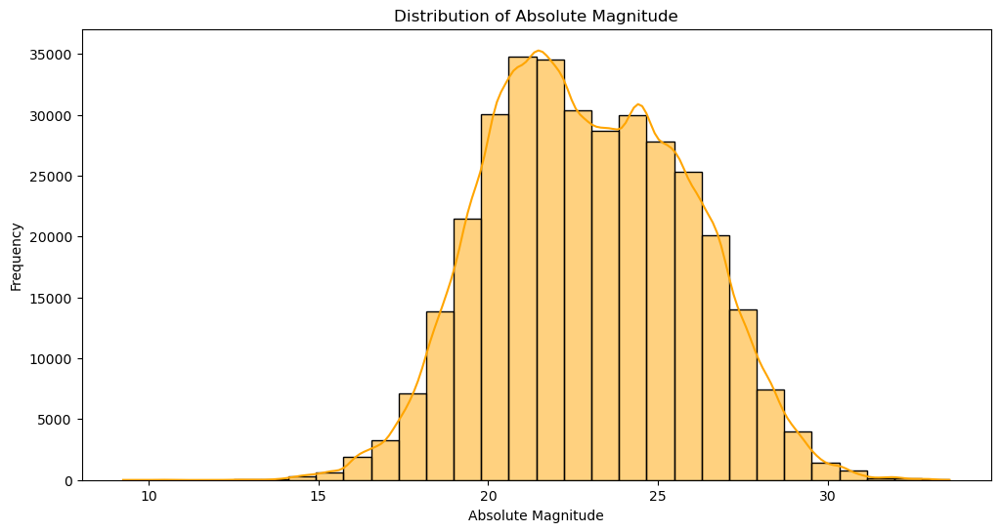

count    338199.000000
mean         22.932525
std           2.911096
min           9.250000
25%          20.740000
50%          22.800000
75%          25.100000
max          33.580000
Name: absolute_magnitude, dtype: float64


In [27]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(12, 6))
sns.histplot(df['absolute_magnitude'].dropna(), kde=True, bins=30, color='orange')
plt.title('Distribution of Absolute Magnitude')
plt.xlabel('Absolute Magnitude')
plt.ylabel('Frequency')
plt.show()

print(df['absolute_magnitude'].describe())

## ***2. Distribution of Minimum Estimated Diameter***

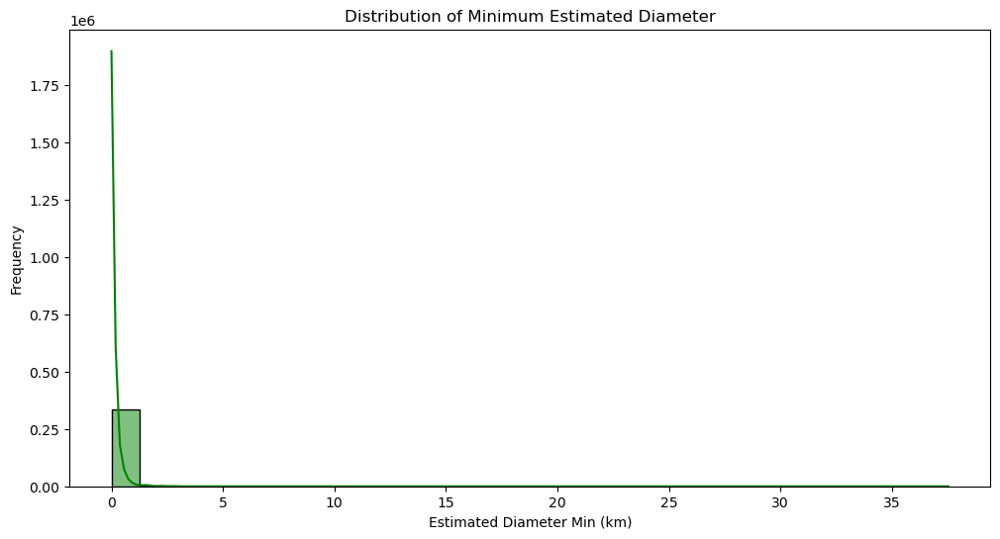

count    338199.000000
mean          0.157812
std           0.313872
min           0.000511
25%           0.025384
50%           0.073207
75%           0.189041
max          37.545248
Name: estimated_diameter_min, dtype: float64


In [29]:
plt.figure(figsize=(12, 6))
sns.histplot(df['estimated_diameter_min'].dropna(), kde=True, bins=30, color='green')
plt.title('Distribution of Minimum Estimated Diameter')
plt.xlabel('Estimated Diameter Min (km)')
plt.ylabel('Frequency')
plt.show()

print(df['estimated_diameter_min'].describe())

## ***3. Distribution of Maximum Estimated Diameter***

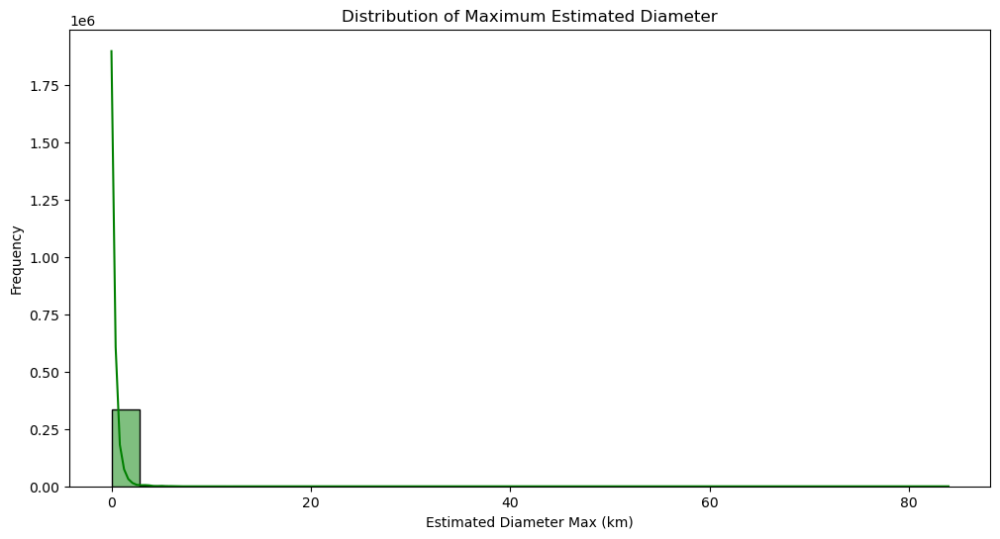

count    338199.000000
mean          0.352878
std           0.701839
min           0.001143
25%           0.056760
50%           0.163697
75%           0.422708
max          83.953727
Name: estimated_diameter_max, dtype: float64


In [31]:
plt.figure(figsize=(12, 6))
sns.histplot(df['estimated_diameter_max'].dropna(), kde=True, bins=30, color='green')
plt.title('Distribution of Maximum Estimated Diameter')
plt.xlabel('Estimated Diameter Max (km)')
plt.ylabel('Frequency')
plt.show()

print(df['estimated_diameter_max'].describe())

## ***4. Distribution of Relative Velocity***

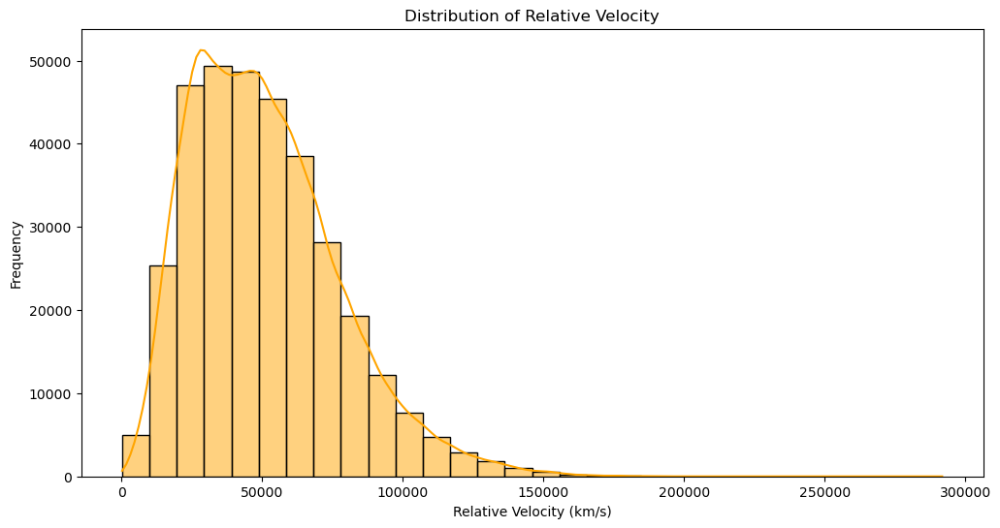

count    338199.000000
mean      51060.662908
std       26399.238435
min         203.346433
25%       30712.031471
50%       47560.465474
75%       66673.820614
max      291781.106613
Name: relative_velocity, dtype: float64


In [33]:
plt.figure(figsize=(12, 6))
sns.histplot(df['relative_velocity'].dropna(), kde=True, bins=30, color='orange')
plt.title('Distribution of Relative Velocity')
plt.xlabel('Relative Velocity (km/s)')
plt.ylabel('Frequency')
plt.show()

print(df['relative_velocity'].describe())

## ***5. Boxplot of Relative Velocity***

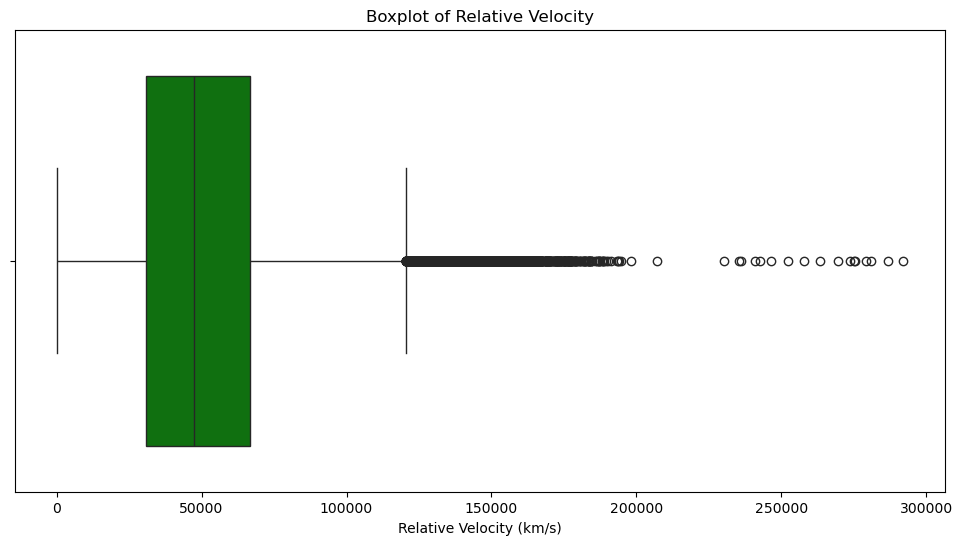

In [35]:
plt.figure(figsize=(12, 6))
sns.boxplot(x=df['relative_velocity'], color='green')
plt.title('Boxplot of Relative Velocity')
plt.xlabel('Relative Velocity (km/s)')
plt.show()

## ***5. Distribution of Miss Distance***

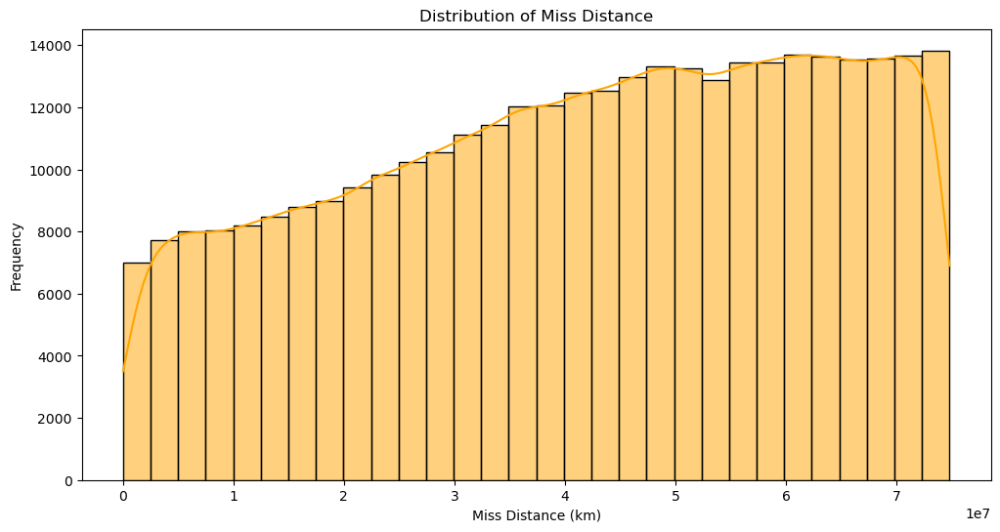

count    3.381990e+05
mean     4.153535e+07
std      2.077399e+07
min      6.745533e+03
25%      2.494540e+07
50%      4.332674e+07
75%      5.933961e+07
max      7.479865e+07
Name: miss_distance, dtype: float64


In [37]:
plt.figure(figsize=(12, 6))
sns.histplot(df['miss_distance'].dropna(), kde=True, bins=30, color='orange')
plt.title('Distribution of Miss Distance')
plt.xlabel('Miss Distance (km)')
plt.ylabel('Frequency')
plt.show()

print(df['miss_distance'].describe())

## ***6. Count of NEOs by Orbiting Body***

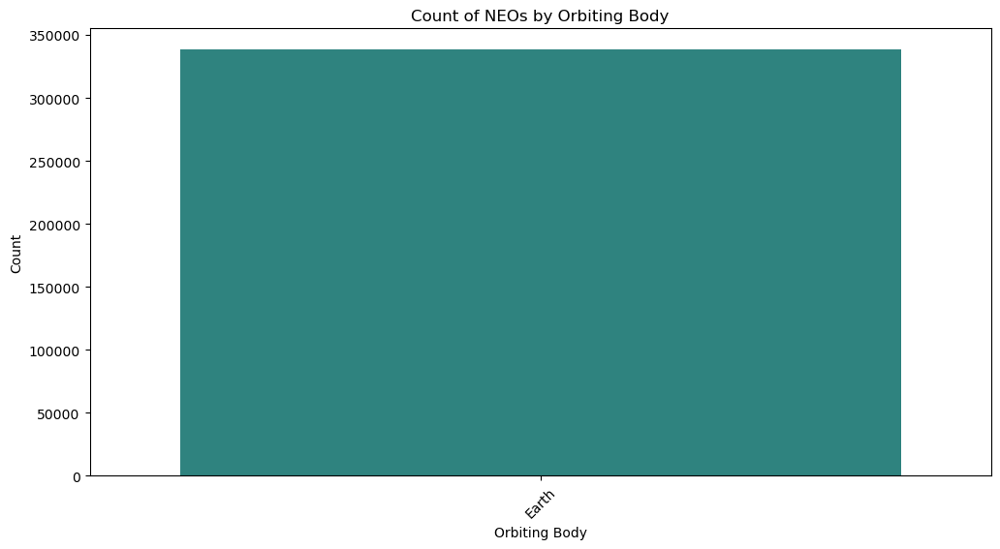

orbiting_body
Earth    338199
Name: count, dtype: int64


In [39]:
plt.figure(figsize=(12, 6))
sns.countplot(data=df, x='orbiting_body', order=df['orbiting_body'].value_counts().index, palette='viridis')
plt.title('Count of NEOs by Orbiting Body')
plt.xlabel('Orbiting Body')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

print(df['orbiting_body'].value_counts())

## ***7. Relative Velocity by Hazardous Status***

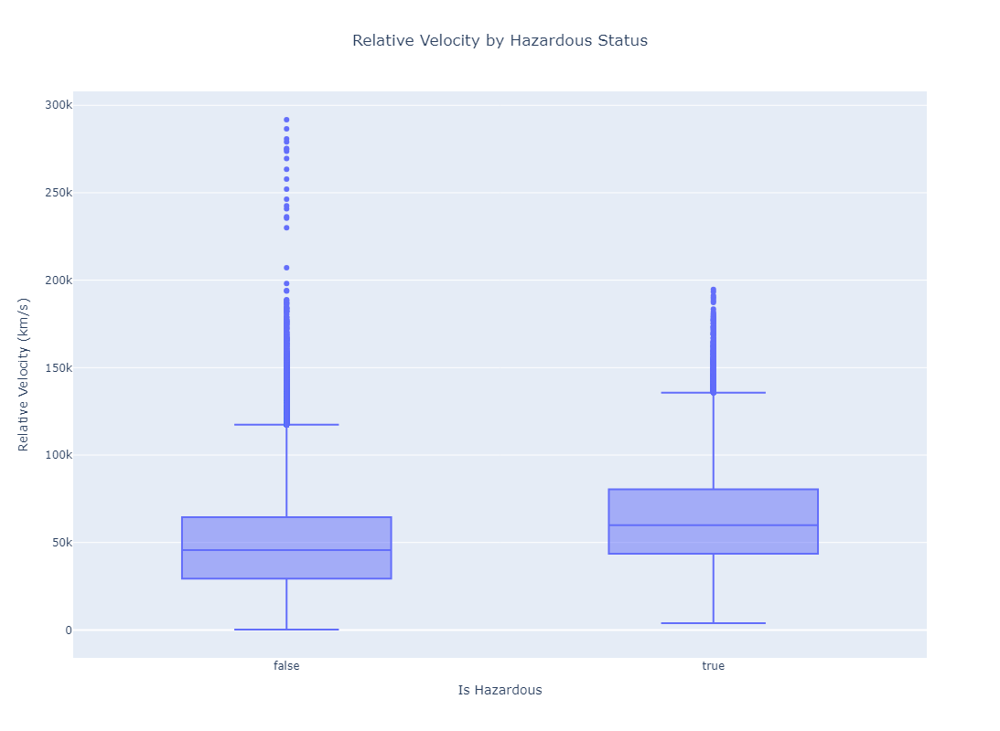

In [41]:
fig = px.box(df, x='is_hazardous', y='relative_velocity', title='Relative Velocity by Hazardous Status',
             labels={'is_hazardous': 'Is Hazardous', 'relative_velocity': 'Relative Velocity (km/s)'})

fig.update_layout(
    xaxis_title='Is Hazardous',
    yaxis_title='Relative Velocity (km/s)',
    title={'text': 'Relative Velocity by Hazardous Status', 'x': 0.5},
    width=1200, 
    height=800   
)
fig.show()

## ***8. Pairplot of Numerical Features***

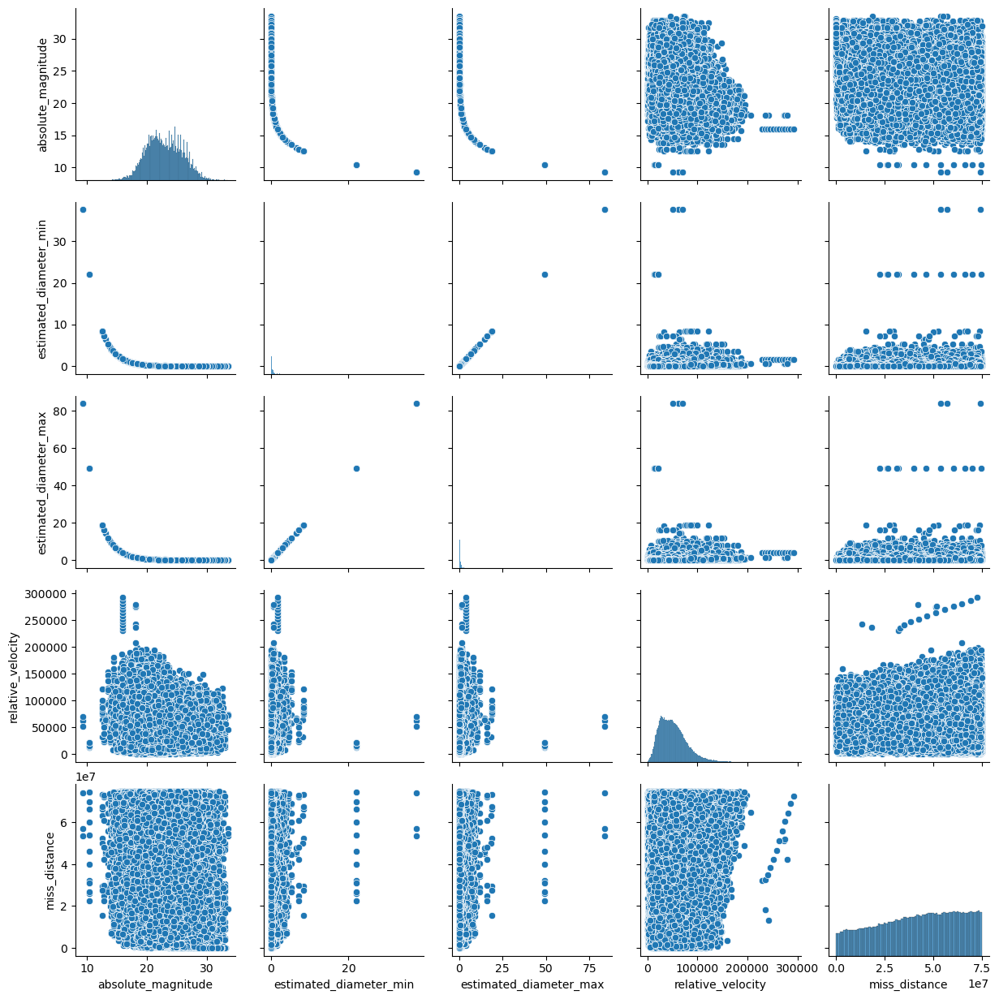

In [43]:
sns.pairplot(df[['absolute_magnitude', 'estimated_diameter_min', 'estimated_diameter_max',
                 'relative_velocity', 'miss_distance']].dropna())
plt.show()

## ***9. Heatmap of Correlations***

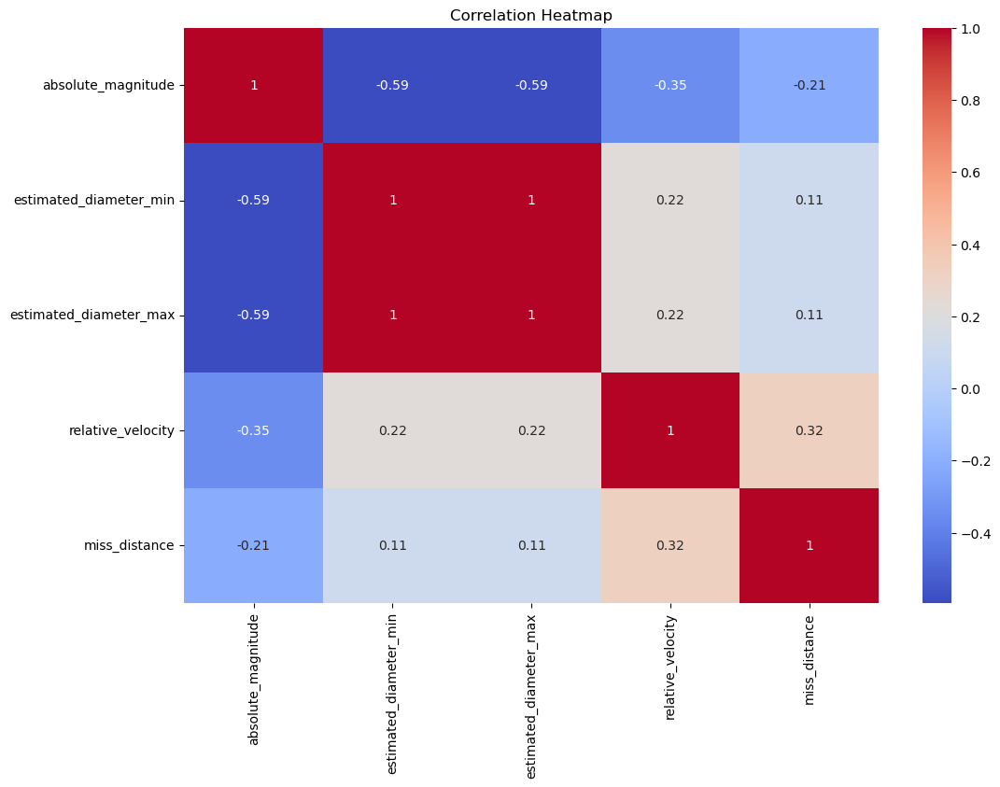

In [45]:
plt.figure(figsize=(12, 8))
sns.heatmap(df[['absolute_magnitude', 'estimated_diameter_min', 'estimated_diameter_max', 'relative_velocity', 'miss_distance']].corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

## ***10. Top 10 Closest NEOs to Earth***

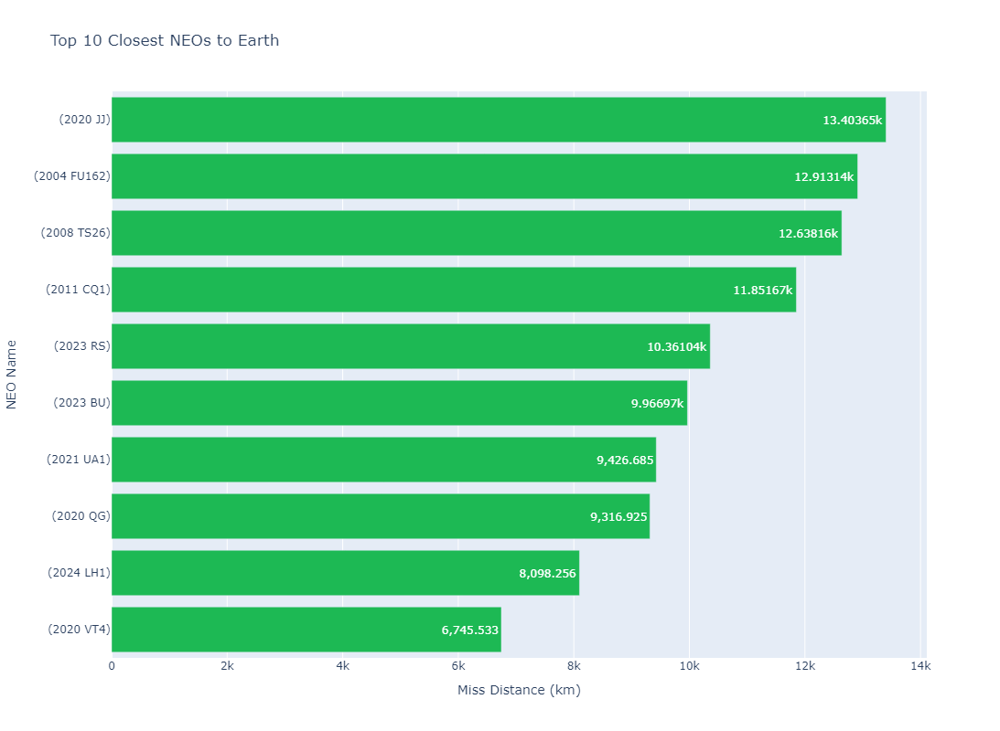

In [47]:
top_10_closest = df.nsmallest(10, 'miss_distance')

fig5 = px.bar(top_10_closest, 
              x='miss_distance', 
              y='name', 
              title='Top 10 Closest NEOs to Earth', 
              text_auto=True,
              labels={'miss_distance': 'Miss Distance (km)', 'name': 'NEO Name'},
              color_discrete_sequence=['#1DB954'],
              width=1200, 
              height=800  )

fig5.show()

## ***11. Proportion of Hazardous vs. Non-Hazardous NEOs***

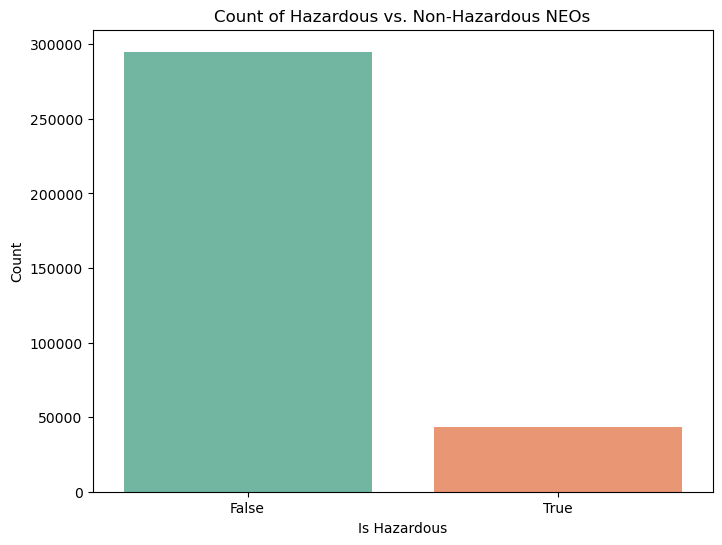

is_hazardous
False    295037
True      43162
Name: count, dtype: int64


In [49]:
plt.figure(figsize=(8, 6))
sns.countplot(data=df, x='is_hazardous', palette='Set2')
plt.title('Count of Hazardous vs. Non-Hazardous NEOs')
plt.xlabel('Is Hazardous')
plt.ylabel('Count')
plt.show()

print(df['is_hazardous'].value_counts())

### ***The "is_hazardous" target column is likely imbalanced, with far fewer hazardous objects compared to non-hazardous ones, So we should handle this imbalance data***

# ***Data Preprocessing***

## ***1. Encoding Categorical Variables***

In [53]:
categorical_features = df.select_dtypes(include=['object', 'category','bool']).columns.tolist()
numerical_features = df.select_dtypes(include=['number']).columns.tolist()

print("Categorical Features:", categorical_features)
print("Numerical Features:", numerical_features)

Categorical Features: ['name', 'orbiting_body', 'is_hazardous']
Numerical Features: ['neo_id', 'absolute_magnitude', 'estimated_diameter_min', 'estimated_diameter_max', 'relative_velocity', 'miss_distance']


In [54]:
label_encoding = LabelEncoder()
for col in categorical_features:
    df[col] = label_encoding.fit_transform(df[col])

In [55]:
df.head()

,neo_id,name,absolute_magnitude,estimated_diameter_min,estimated_diameter_max,orbiting_body,relative_velocity,miss_distance,is_hazardous
0,2162117,30603,19.14,0.394962,0.883161,0,71745.401048,5.814362e+07,0
1,2349507,31395,18.50,0.530341,1.185878,0,109949.757148,5.580105e+07,1
2,2455415,32118,21.45,0.136319,0.304818,0,24865.506798,6.720689e+07,0
3,3132126,736,20.63,0.198863,0.444672,0,78890.076805,3.039644e+07,0
4,3557844,4880,22.70,0.076658,0.171412,0,56036.519484,6.311863e+07,0


## ***2. Feature Selection***

In [57]:
correlation_matrix = df.corr()
print(correlation_matrix['is_hazardous'].sort_values(ascending=False))

is_hazardous              1.000000
relative_velocity         0.187021
estimated_diameter_min    0.164840
estimated_diameter_max    0.164840
name                      0.120058
miss_distance            -0.006540
neo_id                   -0.156748
absolute_magnitude       -0.343994
orbiting_body                  NaN
Name: is_hazardous, dtype: float64


### ***We found that name, neo_id, orbiting_body don't have a significant impact on the target, So I will drop them.***

In [59]:
df = df.drop(columns=['name', 'neo_id', 'orbiting_body', ])

In [60]:
df.head()

,absolute_magnitude,estimated_diameter_min,estimated_diameter_max,relative_velocity,miss_distance,is_hazardous
0,19.14,0.394962,0.883161,71745.401048,5.814362e+07,0
1,18.50,0.530341,1.185878,109949.757148,5.580105e+07,1
2,21.45,0.136319,0.304818,24865.506798,6.720689e+07,0
3,20.63,0.198863,0.444672,78890.076805,3.039644e+07,0
4,22.70,0.076658,0.171412,56036.519484,6.311863e+07,0


## ***3. Scaling Numerical Features***

In [62]:
numerical_features = ['absolute_magnitude', 'estimated_diameter_min', 'estimated_diameter_max', 
                       'relative_velocity', 'miss_distance']

scaler = StandardScaler()
df[numerical_features] = scaler.fit_transform(df[numerical_features])

In [63]:
df

,absolute_magnitude,estimated_diameter_min,estimated_diameter_max,relative_velocity,miss_distance,is_hazardous
0,-1.302784,0.755562,0.755562,0.783537,0.799476,0
1,-1.522633,1.186882,1.186882,2.230715,0.686711,1
2,-0.509268,-0.068479,-0.068479,-0.992271,1.235756,0
3,-0.790949,0.130790,0.130790,1.054176,-0.536196,0
4,-0.079876,-0.258559,-0.258559,0.188485,1.038958,0
...,...,...,...,...,...,...
338194,1.939985,-0.486506,-0.486506,0.211610,1.084537,0
338195,1.977772,-0.487310,-0.487310,-1.133742,-0.579886,0
338196,-0.348160,-0.152844,-0.152844,-1.485978,0.574057,0
338197,0.327875,-0.361407,-0.361407,0.194617,-1.749816,0


## ***4. Handling Imbalanced Classes Using SMOTE***

In [65]:
X = df.drop(columns=['is_hazardous'])
y = df['is_hazardous']

In [66]:
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

print(f'Original y distribution: {y.value_counts()}')
print(f'Resampled y distribution: {pd.Series(y_resampled).value_counts()}')

Original y distribution: is_hazardous
0    295037
1     43162
Name: count, dtype: int64
Resampled y distribution: is_hazardous
0    295037
1    295037
Name: count, dtype: int64


## ***5. Split the Data***

In [68]:
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)

# ***Model Training and Evaluation***

In [70]:
def print_score(clf, X_train, y_train, X_test, y_test, train=True):
    if train:
        pred = clf.predict(X_train)
        clf_report = pd.DataFrame(classification_report(y_train, pred, output_dict=True))
        print("Train Result:\n================================================")
        print(f"Accuracy Score: {accuracy_score(y_train, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        cm = confusion_matrix(y_train, pred)
        
        plt.figure(figsize=(6, 4))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
        plt.title('Confusion Matrix - Train Data')
        plt.ylabel('Actual')
        plt.xlabel('Predicted')
        plt.show()
        
    elif train==False:
        pred = clf.predict(X_test)
        clf_report = pd.DataFrame(classification_report(y_test, pred, output_dict=True))
        print("Test Result:\n================================================")        
        print(f"Accuracy Score: {accuracy_score(y_test, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        cm = confusion_matrix(y_test, pred)
        
        plt.figure(figsize=(6, 4))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
        plt.title('Confusion Matrix - Test Data')
        plt.ylabel('Actual')
        plt.xlabel('Predicted')
        plt.show()

## ***1. Random Forest***

Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best Parameters: {'n_estimators': 100, 'min_samples_split': 20, 'min_samples_leaf': 1, 'max_depth': None}
Train Result:
Accuracy Score: 96.88%
_______________________________________________
CLASSIFICATION REPORT:
                       0              1  accuracy      macro avg  \
precision       0.979937       0.958178  0.968796       0.969057   
recall          0.957143       0.980432  0.968796       0.968788   
f1-score        0.968406       0.969177  0.968796       0.968792   
support    235855.000000  236204.000000  0.968796  472059.000000   

            weighted avg  
precision       0.969049  
recall          0.968796  
f1-score        0.968792  
support    472059.000000  
_______________________________________________


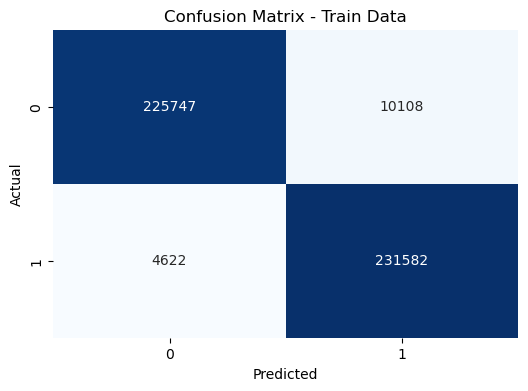

Test Result:
Accuracy Score: 94.00%
_______________________________________________
CLASSIFICATION REPORT:
                      0             1  accuracy      macro avg   weighted avg
precision      0.960654      0.920964  0.939982       0.940809       0.940868
recall         0.917914      0.962181  0.939982       0.940048       0.939982
f1-score       0.938798      0.941122  0.939982       0.939960       0.939956
support    59182.000000  58833.000000  0.939982  118015.000000  118015.000000
_______________________________________________


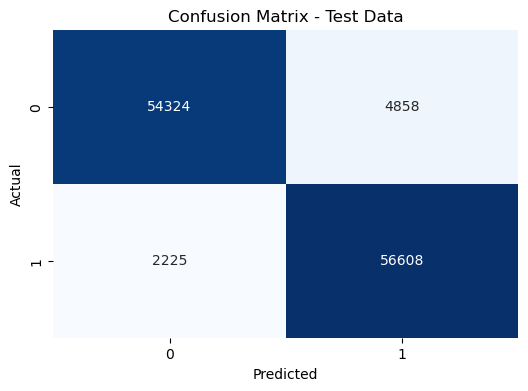

In [72]:
param_grid = {
    'n_estimators': [50, 100, 200, 500],      
    'max_depth': [10, 20, 30, None],           
    'min_samples_split': [2, 10, 20],          
    'min_samples_leaf': [1, 5, 10]     
}

rf = RandomForestClassifier(random_state=42)
random_search = RandomizedSearchCV(
    estimator=rf,          
    param_distributions=param_grid, 
    n_iter=10,            
    cv=5,                  
    verbose=2,             
    random_state=42,     
    n_jobs=-1            
)
random_search.fit(X_train, y_train)
print("Best Parameters:", random_search.best_params_)
best_rf = random_search.best_estimator_
print_score(best_rf, X_train, y_train, X_test, y_test, train=True)
print_score(best_rf, X_train, y_train, X_test, y_test, train=False)

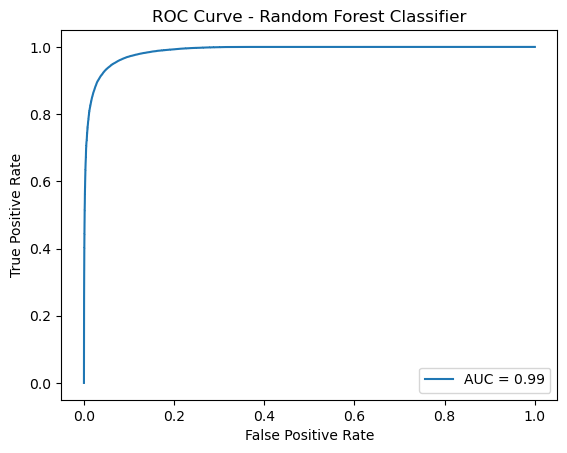

In [73]:
y_pred_proba = best_rf.predict_proba(X_test)[:, 1]
fpr, tpr, _ = roc_curve(y_test, y_pred_proba) 
roc_auc = roc_auc_score(y_test, y_pred_proba)  

plt.plot(fpr, tpr, label="AUC = {:.2f}".format(roc_auc))
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.title('ROC Curve - Random Forest Classifier')
plt.legend(loc=4)
plt.show()

In [74]:
test_score = accuracy_score(y_test, best_rf.predict(X_test)) * 100
train_score = accuracy_score(y_train, best_rf.predict(X_train)) * 100
results_df = pd.DataFrame(data=[["Random Forest Classifier", train_score, test_score]], 
                          columns=['Model', 'Training Accuracy', 'Testing Accuracy'])
results_df

,Model,Training Accuracy,Testing Accuracy
0,Random Forest Classifier,96.879627,93.998221


# ***Performance Evaluation***

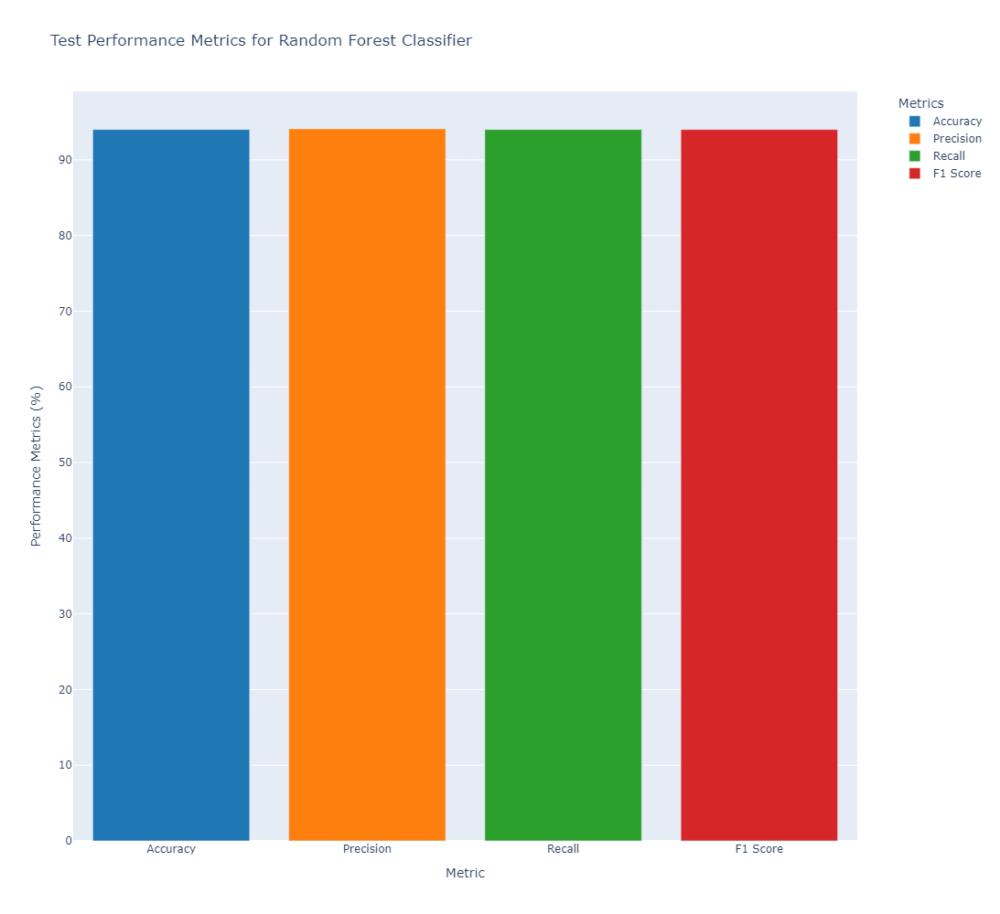

In [103]:
y_pred = best_rf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred) * 100
precision = precision_score(y_test, y_pred, average='weighted') * 100
recall = recall_score(y_test, y_pred, average='weighted') * 100
f1 = f1_score(y_test, y_pred, average='weighted') * 100

metrics = [
    ['Random Forest Classifier', accuracy, precision, recall, f1]
]

df_metrics = pd.DataFrame(metrics, columns=['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score'])
df_metrics.set_index('Model', inplace=True)
df_melted = df_metrics.reset_index().melt(id_vars='Model', var_name='Metric', value_name='Value')

color_sequence = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fig = px.bar(df_melted, x='Metric', y='Value', color='Metric', color_discrete_sequence=color_sequence,
             title='Test Performance Metrics for Random Forest Classifier',
             labels={'Value': 'Performance Metrics (%)'},
             height=1000, width=1000)
fig.update_layout(
    xaxis_title='Metric',
    yaxis_title='Performance Metrics (%)',
    legend_title='Metrics',
    legend=dict(x=1.05, y=1, traceorder='normal'),
    xaxis=dict(tickangle=0),
    width=1000,
    height=1000
)
fig.show()